# Aerial Image Segmentation using U-Net

This Jupyter Notebook aims to segment aerial images using an U-Net model.

The images come from Kaggle's "Aerial Semantic Segmentation Drone Dataset" database.

## Importing Libraries

In [1]:
import os
import numpy as np
import cv2
from tqdm import tqdm
import random
import pandas as pd
import math
import matplotlib.pyplot as plt

from PIL import Image
from sklearn.model_selection import train_test_split

import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.metrics import OneHotMeanIoU, IoU
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, Conv2DTranspose, BatchNormalization
from tensorflow.keras.layers import Activation, MaxPool2D, Concatenate

2024-05-12 01:58:50.375685: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-05-12 01:58:50.375791: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-05-12 01:58:50.646634: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


In [2]:
# Checking if the code is running on the graphics processing unit
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

Num GPUs Available:  2


## Necessary informations

In [3]:
# Insert the paths of the original images and the masks
original_images_path = '/kaggle/input/semantic-drone-dataset/dataset/semantic_drone_dataset/original_images/'
label_images_path = '/kaggle/input/semantic-drone-dataset/dataset/semantic_drone_dataset/label_images_semantic/'

# Insert the CSV file containing the colors (rgb.csv)
class_dict_csv = '/kaggle/input/semantic-drone-dataset/class_dict_seg.csv'

# Insert the number of epochs the model will run
epochs = 100

# Insert the batch size
batch_size = 8

In [4]:
# Image width and height (set to 512x512 as specified in the header)
img_width = 512
img_height = 512

# Number of channels
img_channels = 3

## Loading Images

In [5]:
# A function to count how many times the classes appears in the dataset
def count_class(folder, class_csv):
    count_color = {}

    # Loop through all images in the folder
    for file in os.listdir(folder):
        if file.endswith(".png") or file.endswith(".jpg") or file.endswith(".jpeg"):
            path_img = os.path.join(folder, file)

            # Load the image in grayscale
            img = cv2.imread(path_img, cv2.IMREAD_GRAYSCALE)

            # Get unique colors from the image
            unique_colors = np.unique(img)

            # Update color count
            for color in unique_colors:
                count_color[color] = count_color.get(color, 0) + 1

    # Reading the csv with the classes
    classes = pd.read_csv(class_csv)
    
    # Map color values to classes according to the provided list
    map_class = {}
    for idx, row in classes.iterrows():
        map_class[idx] = row['name']

    # Create DataFrame from the count dictionary
    df_count = pd.DataFrame(list(count_color.items()), columns=['Color', 'Count'])

    # Sort the DataFrame in ascending order of "Color" column values
    df_count = df_count.sort_values(by='Color')

    # Replace color name with class
    df_count['Class'] = df_count['Color'].map(map_class)

    # Discard the "Color" column and reorder the columns
    df_count = df_count[['Class', 'Count']]

    return df_count

# how many time each class appear in the dataset
print(count_class(label_images_path, class_dict_csv).to_string(index=False))

     Class  Count
 unlabeled    398
paved-area    380
      dirt    332
     grass    273
    gravel    330
     water    111
     rocks    210
      pool     40
vegetation    359
      roof    199
      wall    292
    window    151
      door     37
     fence    212
fence-pole    167
    person    367
       dog     21
       car     64
   bicycle    154
      tree    186
 bald-tree     83
 ar-marker    165
  obstacle    389


In [6]:
# Function to get the images and masks extensions
def file_extension(path):    
    name = path.split("/")[-1].split(".")
    file_extn = name[1] # file extension

    return file_extn


# Function created to generate a path for a random image for future plotting
def random_file(path):
    # Lists all files in a directory
    files = os.listdir(path)
    
    # Filters only files (removes subdirectories)
    files = [file for file in files if os.path.isfile(os.path.join(path, file))]
    
    # Returns a random file
    return random.choice(files)


# the images extension
img_ext = file_extension(random_file(original_images_path))

# the masks extension
mask_ext = file_extension(random_file(label_images_path))

None


[ WARN:0@258.164] global loadsave.cpp:248 findDecoder imread_('040.jpg'): can't open/read file: check file path/integrity


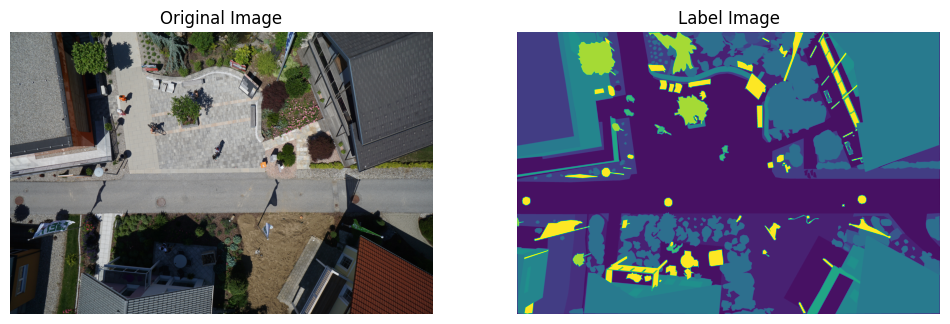

In [7]:
# A random image and mask will be displayed
random_img = random_file(original_images_path)

random_mask = f'{random_img.split(".")[0]}.{mask_ext}'

print(cv2.imread(random_img))

fig = plt.figure(figsize=(12,7))

fig.add_subplot(1,2,1) 
plt.imshow(cv2.cvtColor(cv2.imread(original_images_path + random_img), cv2.COLOR_BGR2RGB))
plt.axis("off")
plt.title("Original Image")

fig.add_subplot(1,2,2) 
plt.imshow(cv2.imread(label_images_path + random_mask, cv2.IMREAD_GRAYSCALE))
plt.axis("off")
plt.title("Label Image")
plt.show()

In [8]:
# Function to create a DataFrame from file names in a directory
def create_dataframe(path):
    # List to store file names
    name = []
    
    # Iterates over the files in the specified directory
    for dirname, _, filenames in os.walk(path):
        for filename in filenames:
            # Adds the file name (without extension) to the list
            name.append(filename.split('.')[0])
    
    # Creates a DataFrame with the file names as a column named 'id'
    return pd.DataFrame({'id': name}, index=np.arange(0, len(name)))


# Creates a DataFrame for the original images
df_images = create_dataframe(original_images_path)

# Creates a DataFrame for the masks
df_masks = create_dataframe(label_images_path)

# Prints the total number of images found
print('Total Images: ', len(df_images))

Total Images:  400


In [9]:
# Division of the DataFrame into training, testing, and validation sets
# Uses the train_test_split function from scikit-learn to split the data
# X_trainval contains a fraction of the data for training and validation, and X_test contains the rest for testing
X_trainval, X_test = train_test_split(df_images['id'], test_size=0.1, random_state=20)

# Divides X_trainval again into training and validation sets
# X_train contains the majority of the data for training and X_val contains a fraction for validation
X_train, X_val = train_test_split(X_trainval, test_size=0.2, random_state=34)

# Prints the size of each set
print(f"Train Size : {len(X_train)} images")
print(f"Val Size   :  {len(X_val)} images")
print(f"Test Size  :  {len(X_test)} images")

# Defines the labels for the training, testing, and validation sets
y_train = X_train
y_test = X_test
y_val = X_val

# Constructs lists of file paths for images and masks in each set
img_train = [os.path.join(original_images_path, f"{name}.{img_ext}") for name in X_train]
mask_train = [os.path.join(label_images_path, f"{name}.{mask_ext}") for name in y_train]
img_val = [os.path.join(original_images_path, f"{name}.{img_ext}") for name in X_val]
mask_val = [os.path.join(label_images_path, f"{name}.{mask_ext}") for name in y_val]
img_test = [os.path.join(original_images_path, f"{name}.{img_ext}") for name in X_test]
mask_test = [os.path.join(label_images_path, f"{name}.{mask_ext}") for name in y_test]


Train Size : 288 images
Val Size   :  72 images
Test Size  :  40 images


In [10]:
# DataFrame generated from the CSV file of colors
pd.read_csv(class_dict_csv)

,name,r,g,b
0,unlabeled,0,0,0
1,paved-area,128,64,128
2,dirt,130,76,0
3,grass,0,102,0
4,gravel,112,103,87
5,water,28,42,168
6,rocks,48,41,30
7,pool,0,50,89
8,vegetation,107,142,35
9,roof,70,70,70


In [11]:
# Number of level 2 classes plus the unlabeled class
num_classes = len(pd.read_csv(class_dict_csv))
num_classes

24

## Building Neural Network

In [12]:
# Definition of a convolutional block with two convolutional layers
# This block is a basic operation in convolutional neural networks to extract features from an image
def conv_block(input, num_filters):
  # First convolutional layer
  x = Conv2D(num_filters, 3, padding='same')(input)  # Applies convolution with num_filters filters and a filter size of 3x3
  x = BatchNormalization()(x)  # Normalizes the output channel values
  x = Activation('relu')(x)    # Applies ReLU (Rectified Linear Unit) activation function

  # Second convolutional layer
  x = Conv2D(num_filters, 3, padding='same')(x)  # Another convolution with num_filters filters and a filter size of 3x3
  x = BatchNormalization()(x)  # Normalization
  x = Activation('relu')(x)    # ReLU

  return x  # Returns the output of the convolutional block


# Definition of an encoder block in a U-Net architecture
# This block consists of a convolutional layer followed by a max pooling layer
def encoder_block(input, num_filters):
  # Calling the conv_block function to create a convolutional layer
  x = conv_block(input, num_filters)
  
  # Max pooling layer to reduce the dimensionality of the input by half
  p = MaxPool2D((2,2))(x)  # Using max pooling with a filter size of 2x2 and default stride
  
  return x, p  # Returns the output of the convolutional block (x) and the output of max pooling (p)


# Definition of a decoder block in a U-Net architecture
# This block consists of a transposed convolutional layer followed by concatenation with encoder features and a convolutional layer
def decoder_block(input, skip_features, num_filters):
  # Transposed convolutional layer to increase the spatial resolution of the input
  x = Conv2DTranspose(num_filters, (2,2), strides=2, padding='same')(input)  # Using transposed convolution with a filter size of 2x2 and stride 2
  
  # Concatenation with encoder features
  x = Concatenate()([x, skip_features])  # Concatenates the output of the transposed convolution with the encoder features
  
  # Calling the conv_block function to create a convolutional layer
  x = conv_block(x, num_filters)
  
  return x  # Returns the output of the block


In [13]:
# Definition of a U-Net network architecture
# This architecture consists of encoder and decoder blocks, which are used for image segmentation
def unet_model(input_shape):
  # Input layer of the network
  inputs = Input(input_shape)

  # Encoder: convolutional blocks to extract features from the input images
  s1, p1 = encoder_block(inputs, 64)    # First encoder block
  s2, p2 = encoder_block(p1, 128)       # Second encoder block
  s3, p3 = encoder_block(p2, 256)       # Third encoder block
  s4, p4 = encoder_block(p3, 512)       # Fourth encoder block

  # Bottleneck: convolutional block to process features at a reduced resolution
  b1 = conv_block(p4, 1024)

  # Decoder: blocks to perform upsampling and generate the output mask
  d1 = decoder_block(b1, s4, 512)  # First decoder block
  d2 = decoder_block(d1, s3, 256)  # Second decoder block
  d3 = decoder_block(d2, s2, 128)  # Third decoder block
  d4 = decoder_block(d3, s1, 64)   # Fourth decoder block

  # Output layer: convolution to generate the final segmentation mask
  outputs = Conv2D(num_classes, 1, padding='same', activation='softmax')(d4)

  # Model creation
  model = Model(inputs, outputs, name='UNet')
  return model

In [14]:
# Instantiation of the U-Net model with specified input dimensions
model = unet_model((img_height, img_width, img_channels))

# Compilation of the model with Adam optimizer, categorical crossentropy loss function, and accuracy and IoU metrics
model.compile(optimizer=Adam(learning_rate=1e-4),
              loss='categorical_crossentropy',
              metrics=['accuracy',
                       OneHotMeanIoU(num_classes=num_classes)])

# Prints a summary of the model, showing the network architecture and the number of parameters
model.summary()

Model: "UNet"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 512, 512,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d (Conv2D)     │ (None, 512, 512,  │      1,792 │ input_layer[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalization │ (None, 512, 512,  │        256 │ conv2d[0][0]      │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation          │ (None, 512, 512,  │          0 │ batch_normalizat… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1 (Conv2D)   │ (None, 512, 512,  │     36,928 │ activation[0][0]  │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 512, 512,  │        256 │ conv2d_1[0][0]    │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_1        │ (None, 512, 512,  │          0 │ batch_normalizat… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d       │ (None, 256, 256,  │          0 │ activation_1[0][… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_2 (Conv2D)   │ (None, 256, 256,  │     73,856 │ max_pooling2d[0]… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 256, 256,  │        512 │ conv2d_2[0][0]    │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_2        │ (None, 256, 256,  │          0 │ batch_normalizat… │
│ (Activation)        │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_3 (Conv2D)   │ (None, 256, 256,  │    147,584 │ activation_2[0][… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 256, 256,  │        512 │ conv2d_3[0][0]    │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_3        │ (None, 256, 256,  │          0 │ batch_normalizat… │
│ (Activation)        │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_1     │ (None, 128, 128,  │          0 │ activation_3[0][… │
│ (MaxPooling2D)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_4 (Conv2D)   │ (None, 128, 128,  │    295,168 │ max_pooling2d_1[… │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 128, 128,  │      1,024 │ conv2d_4[0][0]  

 Total params: 31,056,792 (118.47 MB)

 Trainable params: 31,045,016 (118.43 MB)

 Non-trainable params: 11,776 (46.00 KB)

### Callbacks

In [15]:
# Function that creates a directory if it doesn't exist
def create_dir(path):
    # Checks if the directory does not exist
    if not os.path.exists(path):
        # Creates the directory
        os.makedirs(path)

        
# Creating the folder where trained model weights and final model will be saved
create_dir('data/models/')  # Creates the 'models/' directory if it doesn't exist

# Defines the name of the folder where model weights will be saved
folderName = 'data/models/'

# Defines the path to save the model weights
checkpoint_path = folderName
checkpoint_path += "/cp-{epoch:04d}.weights.h5"  # The format of the weight files' name is 'cp-XXXX.weights.h5', where XXXX is the epoch number

# Calculates the number of batches per epoch
n_batches = math.ceil(len(X_train) / batch_size)

# Creates a callback that saves the model weights periodically during training
cp_callback = tf.keras.callbacks.ModelCheckpoint(filepath=checkpoint_path,  # Path to save the weights
                                                 save_weights_only=True,  # Save only the model weights
                                                 save_freq=25*n_batches,  # Frequency of saving weights (every 25 batches per epoch)
                                                 verbose=1)  # Display information about saving

# Saves the initial model weights using the format defined in 'checkpoint_path'
model.save_weights(checkpoint_path.format(epoch=0))  # Saves the weights after epoch 0

### Training

In [16]:
def read_image(x):
    x = cv2.imread(x, cv2.IMREAD_COLOR)
    x = cv2.resize(x, (img_width, img_height))
    x = x/255.0
    x = x.astype(np.float32)
    return x


def read_mask(x):
    x = cv2.imread(x, cv2.IMREAD_GRAYSCALE)
    x = cv2.resize(x, (img_width, img_height))
    x = x.astype(np.int32)
    return x

# Function to create a TensorFlow dataset
def tf_dataset(x, y, batch=batch_size):
    # Creates a dataset from tensors (image and mask file paths)
    dataset = tf.data.Dataset.from_tensor_slices((x, y))
    # Shuffles the dataset
    dataset = dataset.shuffle(buffer_size=500)
    # Applies the preprocessing function
    dataset = dataset.map(preprocess)
    # Batches the data
    dataset = dataset.batch(batch)
    # Repeats the dataset indefinitely
    dataset = dataset.repeat()
    # Preloads batches to speed up training
    dataset = dataset.prefetch(2)
    return dataset

# Preprocessing function to normalize and convert images and masks
def preprocess(x, y):
    # Internal function to decode file paths
    def f(x, y):
        x = x.decode()
        y = y.decode()
        # Reads the image and mask
        image = read_image(x)
        mask = read_mask(y)
        return image, mask
    
    # Applies function f using numpy_function
    image, mask = tf.numpy_function(f, [x, y], [tf.float32, tf.int32])
    # Converts the mask into one-hot encoding
    mask = tf.one_hot(mask, num_classes, dtype=tf.int32)
    # Sets the shapes of the images and masks
    image.set_shape([img_height, img_width, 3])    # In images, number of channels = 3
    mask.set_shape([img_height, img_width, num_classes])    # In masks, number of channels = number of classes
    return image, mask

In [17]:
# Calculate the number of training and validation steps
train_steps = len(img_train) // batch_size
valid_steps = len(img_val) // batch_size

# Create training and validation datasets
train_dataset = tf_dataset(img_train, mask_train, batch=batch_size)
valid_dataset = tf_dataset(img_val, mask_val, batch=batch_size)

In [18]:
# Train the model
history = model.fit(train_dataset,
                    steps_per_epoch=train_steps, 
                    epochs=epochs, 
                    validation_data=valid_dataset, validation_steps=valid_steps,
                    callbacks=[cp_callback]
                    )

Epoch 1/100


2024-05-12 02:04:51.705183: E external/local_xla/xla/service/slow_operation_alarm.cc:65] Trying algorithm eng36{k2=1,k3=0} for conv (f32[8,64,512,512]{3,2,1,0}, u8[0]{0}) custom-call(f32[8,128,512,512]{3,2,1,0}, f32[64,128,3,3]{3,2,1,0}, f32[64]{0}), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBiasActivationForward", backend_config={"conv_result_scale":1,"activation_mode":"kNone","side_input_scale":0,"leakyrelu_alpha":0} is taking a while...
2024-05-12 02:04:51.765385: E external/local_xla/xla/service/slow_operation_alarm.cc:133] The operation took 1.060315729s
Trying algorithm eng36{k2=1,k3=0} for conv (f32[8,64,512,512]{3,2,1,0}, u8[0]{0}) custom-call(f32[8,128,512,512]{3,2,1,0}, f32[64,128,3,3]{3,2,1,0}, f32[64]{0}), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBiasActivationForward", backend_config={"conv_result_scale":1,"activation_mode":"kNone","side_input_scale":0,"leakyrelu_alpha":0} is

36/36 ━━━━━━━━━━━━━━━━━━━━ 525s 5s/step - accuracy: 0.2120 - loss: 2.9895 - one_hot_mean_io_u: 0.0365 - val_accuracy: 0.3728 - val_loss: 3.0127 - val_one_hot_mean_io_u: 0.0162
Epoch 2/100
36/36 ━━━━━━━━━━━━━━━━━━━━ 174s 5s/step - accuracy: 0.5430 - loss: 2.0576 - one_hot_mean_io_u: 0.0977 - val_accuracy: 0.3729 - val_loss: 2.7745 - val_one_hot_mean_io_u: 0.0162
Epoch 3/100
36/36 ━━━━━━━━━━━━━━━━━━━━ 173s 5s/step - accuracy: 0.5819 - loss: 1.8682 - one_hot_mean_io_u: 0.1115 - val_accuracy: 0.3741 - val_loss: 2.6654 - val_one_hot_mean_io_u: 0.0165
Epoch 4/100
36/36 ━━━━━━━━━━━━━━━━━━━━ 174s 5s/step - accuracy: 0.6262 - loss: 1.6776 - one_hot_mean_io_u: 0.1281 - val_accuracy: 0.3729 - val_loss: 2.6160 - val_one_hot_mean_io_u: 0.0162
Epoch 5/100
36/36 ━━━━━━━━━━━━━━━━━━━━ 174s 5s/step - accuracy: 0.6477 - loss: 1.5521 - one_hot_mean_io_u: 0.1361 - val_accuracy: 0.3729 - val_loss: 2.5485 - val_one_hot_mean_io_u: 0.0162
Epoch 6/100
36/36 ━━━━━━━━━━━━━━━━━━━━ 173s 5s/step - accuracy: 0.6696 -

In [19]:
# Saves the model in the models folder
model.save(f'{folderName}/model.keras')

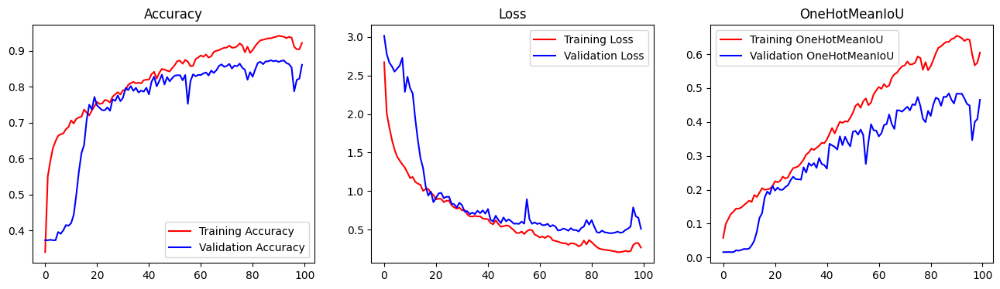

In [20]:
# Function created to display the accuracy, loss, and mean IoU graphs for training
def plot_graphs(history):
  fig = plt.gcf()
  fig.set_size_inches(16,4)
  plt.subplot(1,3,1)
  plt.plot(history.history['accuracy'], 'red', label='Training Accuracy')
  plt.plot(history.history['val_accuracy'], 'blue', label='Validation Accuracy')
  plt.legend()
  plt.title('Accuracy')

  plt.subplot(1,3,2)
  plt.plot(history.history['loss'], 'red', label='Training Loss')
  plt.plot(history.history['val_loss'], 'blue', label='Validation Loss')
  plt.legend()
  plt.title('Loss')

  plt.subplot(1,3,3)
  plt.plot(history.history['one_hot_mean_io_u'], 'red', label='Training OneHotMeanIoU')
  plt.plot(history.history['val_one_hot_mean_io_u'], 'blue', label='Validation OneHotMeanIoU')
  plt.legend()
  plt.title('OneHotMeanIoU')
  plt.show()


# Plotting the graphs
plot_graphs(history)

### Tests

In [21]:
# loading the trained model
loaded_model = tf.keras.models.load_model(f'{folderName}/model.keras')

In [22]:
# Creation of a folder for the prediction results
predict_path = 'data/results1/'
create_dir(predict_path)

In [23]:
for x, y in tqdm(zip(img_test, mask_test), total=len(img_test)):
    name = y.split("/")[-1]
    
    ## Read the original image
    x = cv2.imread(x, cv2.IMREAD_COLOR)
    x = cv2.resize(x, (img_width, img_height))
    x = x/255.0
    x = x.astype(np.float32)

    ## Read the mask
    y = cv2.imread(y, cv2.IMREAD_GRAYSCALE)
    y = cv2.resize(y, (img_width, img_height))
    
    # Expand the dimensions of the mask to add a channel, making it (256,256,1).
    y = np.expand_dims(y, axis=-1)
    
    # Normalize the mask values to be in the range [0, 255], according to the number of classes.
    y = y.astype(np.int32)

    # Expand the mask to have 3 channels, to match the image dimension.
    y = np.concatenate([y, y, y], axis=2)
    
    ## Prediction
    # Make the mask prediction using the loaded model, providing the input image.
    p = loaded_model.predict(np.expand_dims(x, axis=0))[0]

    # Get the class with the highest probability for each pixel of the predicted mask.
    p = np.argmax(p, axis=-1)
    
    # Expand the dimensions of the predicted mask to add a channel.
    p = np.expand_dims(p, axis=-1)  
    
    # Normalize the values of the predicted mask to be in the range [0, 255], according to the number of classes.
    p = p.astype(np.int32)

    # Expand the predicted mask to have 3 channels, to match the image dimension.
    p = np.concatenate([p, p, p], axis=2)
    
    # Save the predicted mask as an image using OpenCV.
    cv2.imwrite(predict_path + name, p)

  0%|          | 0/40 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 16s 16s/step


  2%|▎         | 1/40 [00:17<11:07, 17.12s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


  5%|▌         | 2/40 [00:17<04:43,  7.47s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


  8%|▊         | 3/40 [00:18<02:42,  4.40s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


 10%|█         | 4/40 [00:19<01:46,  2.95s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


 12%|█▎        | 5/40 [00:20<01:15,  2.16s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


 15%|█▌        | 6/40 [00:20<00:56,  1.68s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


 18%|█▊        | 7/40 [00:21<00:45,  1.37s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


 20%|██        | 8/40 [00:22<00:37,  1.16s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


 22%|██▎       | 9/40 [00:22<00:31,  1.03s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


 25%|██▌       | 10/40 [00:23<00:28,  1.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


 28%|██▊       | 11/40 [00:24<00:25,  1.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


 30%|███       | 12/40 [00:25<00:23,  1.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


 32%|███▎      | 13/40 [00:25<00:21,  1.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


 35%|███▌      | 14/40 [00:26<00:20,  1.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


 38%|███▊      | 15/40 [00:27<00:19,  1.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


 40%|████      | 16/40 [00:28<00:18,  1.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


 42%|████▎     | 17/40 [00:28<00:17,  1.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


 45%|████▌     | 18/40 [00:29<00:16,  1.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


 48%|████▊     | 19/40 [00:30<00:15,  1.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


 50%|█████     | 20/40 [00:31<00:15,  1.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


 52%|█████▎    | 21/40 [00:31<00:14,  1.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


 55%|█████▌    | 22/40 [00:32<00:13,  1.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


 57%|█████▊    | 23/40 [00:33<00:12,  1.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


 60%|██████    | 24/40 [00:34<00:11,  1.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


 62%|██████▎   | 25/40 [00:34<00:11,  1.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


 65%|██████▌   | 26/40 [00:35<00:10,  1.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


 68%|██████▊   | 27/40 [00:36<00:09,  1.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


 70%|███████   | 28/40 [00:37<00:08,  1.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


 72%|███████▎  | 29/40 [00:37<00:08,  1.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


 75%|███████▌  | 30/40 [00:38<00:07,  1.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


 78%|███████▊  | 31/40 [00:39<00:06,  1.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


 80%|████████  | 32/40 [00:39<00:05,  1.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


 82%|████████▎ | 33/40 [00:40<00:05,  1.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


 85%|████████▌ | 34/40 [00:41<00:04,  1.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


 88%|████████▊ | 35/40 [00:42<00:03,  1.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


 90%|█████████ | 36/40 [00:43<00:03,  1.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


 92%|█████████▎| 37/40 [00:43<00:02,  1.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


 95%|█████████▌| 38/40 [00:44<00:01,  1.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


 98%|█████████▊| 39/40 [00:45<00:00,  1.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


100%|██████████| 40/40 [00:45<00:00,  1.15s/it]


In [24]:
# Calculates the IoU for each class and returns a DataFrame
def iou_result(mask, predict, class_csv):
    # Read the mask image and predicted image
    mask_ = read_mask(mask)
    predict_ = read_mask(predict)

    # Reading the csv with the classes
    classes = pd.read_csv(class_csv)

    # Count the number of classes
    n_classes = len(classes)

    # Dictionary to store IoU values for each class
    iou_dict = {}

    # Iterate through unique predicted class IDs
    for id in np.unique(predict_):
        # Check if the class ID exists in ground truth classes
        if id in np.unique(mask_):
            # Calculate IoU for the current class ID
            iou_img = IoU(num_classes=n_classes, target_class_ids=[id])    
            iou_img.update_state(mask_, predict_)
            iou_value = iou_img.result().numpy()
            iou_dict[id] = iou_value
        
    # Map color values to classes according to the provided list
    map_class = {}
    for idx, row in classes.iterrows():
        map_class[idx] = row['name']

    # Create DataFrame from the count dictionary
    iou_df = pd.DataFrame(list(iou_dict.items()), columns=['Num Class', 'IoU'])

    # Replace color name with class
    iou_df['Class'] = iou_df['Num Class'].map(map_class)

    # Discard the "Num Class" column and reorder the columns
    iou_df = iou_df[['Class', 'IoU']]

    return iou_df

570.png - IoU results
     Class      IoU
paved-area 0.919377
      dirt 0.669079
     grass 0.000000
    gravel 0.383072
     rocks 0.199332
vegetation 0.875087
      roof 0.923605
      wall 0.000000
    window 0.000357
     fence 0.000000
    person 0.155244
   bicycle 0.029101
  obstacle 0.136857


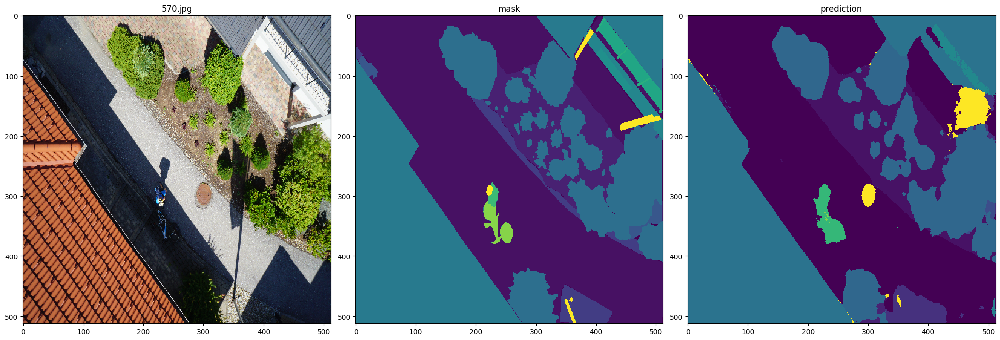

342.png - IoU results
     Class      IoU
paved-area 0.864226
      dirt 0.547713
     grass 0.942132
    gravel 0.885116
     water 0.746130
      pool 0.966408
vegetation 0.113723
      roof 0.885096
      wall 0.669359
    window 0.000000
     fence 0.182027
    person 0.140116
       car 0.000000
   bicycle 0.000000
 bald-tree 0.575056
 ar-marker 0.261649
  obstacle 0.486257


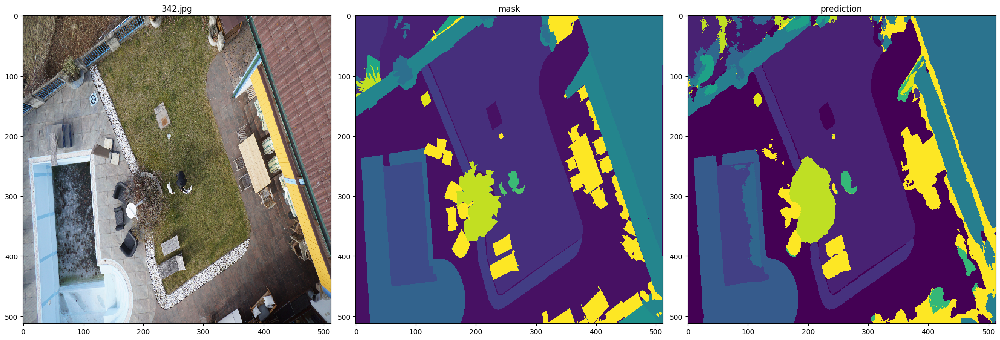

390.png - IoU results
     Class      IoU
paved-area 0.940101
      dirt 0.707896
     grass 0.925279
    gravel 0.684454
     rocks 0.000000
vegetation 0.592898
      roof 0.000000
      wall 0.434063
    window 0.807394
     fence 0.697907
    person 0.577627
      tree 0.000000
 ar-marker 0.000000
  obstacle 0.256422


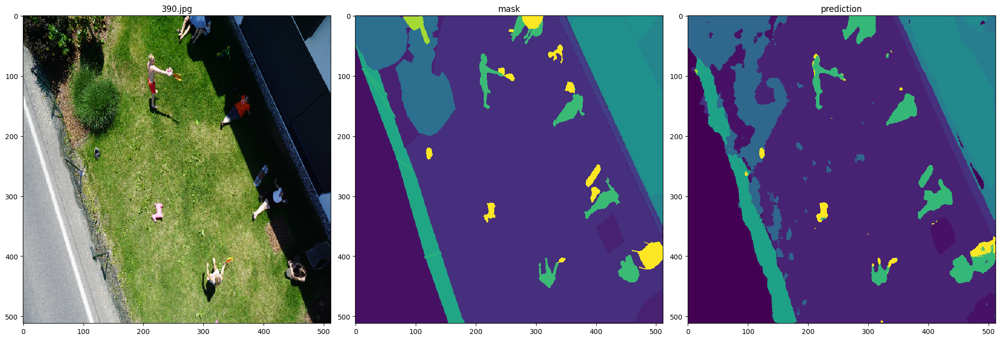

434.png - IoU results
     Class      IoU
 unlabeled 0.000000
paved-area 0.898797
      dirt 0.000722
     grass 0.806997
    gravel 0.000000
vegetation 0.165688
      roof 0.000000
      wall 0.132400
     fence 0.379031
    person 0.294631
   bicycle 0.000000
      tree 0.905068
 bald-tree 0.000439
 ar-marker 0.637011
  obstacle 0.391255


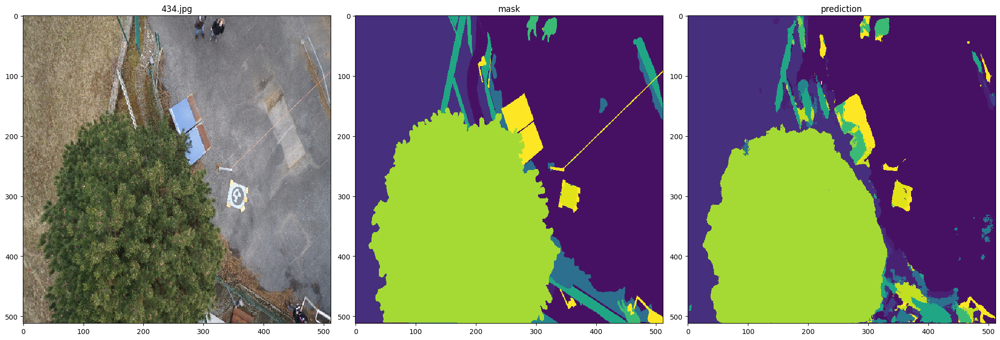

176.png - IoU results
     Class      IoU
paved-area 0.906497
      dirt 0.525029
     grass 0.919762
    gravel 0.899471
     water 0.339560
     rocks 0.081229
vegetation 0.764492
      roof 0.913600
      wall 0.667704
    window 0.651798
     fence 0.371734
    person 0.291667
   bicycle 0.000000
      tree 0.781783
 bald-tree 0.000000
 ar-marker 0.542056
  obstacle 0.642884


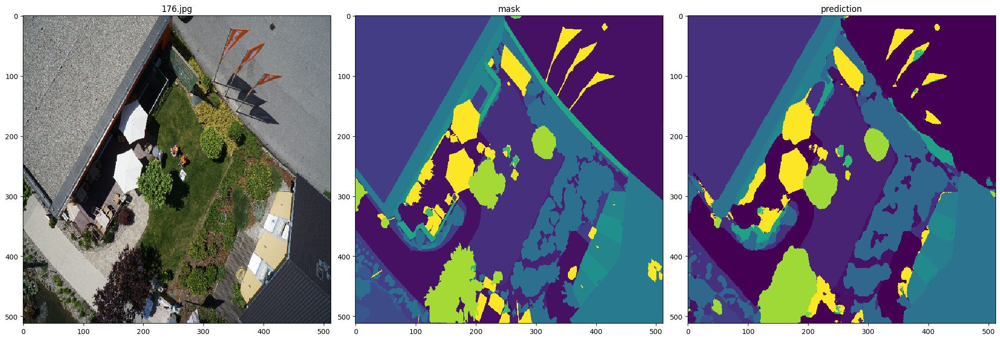

529.png - IoU results
     Class      IoU
paved-area 0.252025
      dirt 0.350826
     grass 0.971837
    gravel 0.000000
vegetation 0.000000
     fence 0.328561
    person 0.669861
   bicycle 0.155882


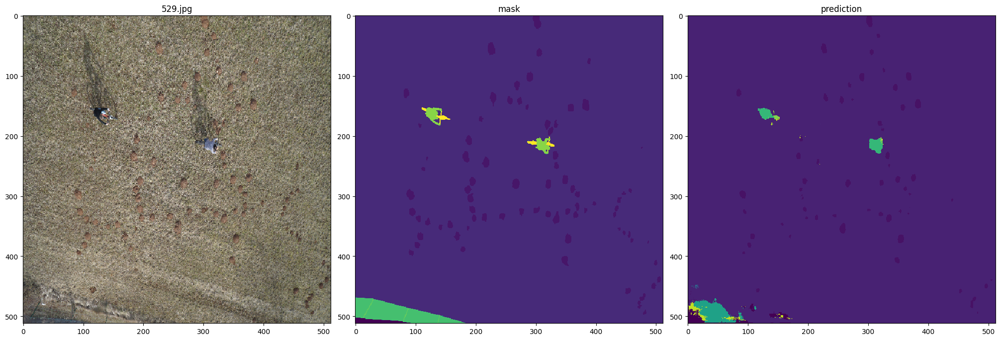

110.png - IoU results
     Class      IoU
paved-area 0.959022
    gravel 0.861379
vegetation 0.168707
      roof 0.000250
      wall 0.040650
     fence 0.154845
    person 0.821710
   bicycle 0.000000
      tree 0.001631
 bald-tree 0.000000
  obstacle 0.229122


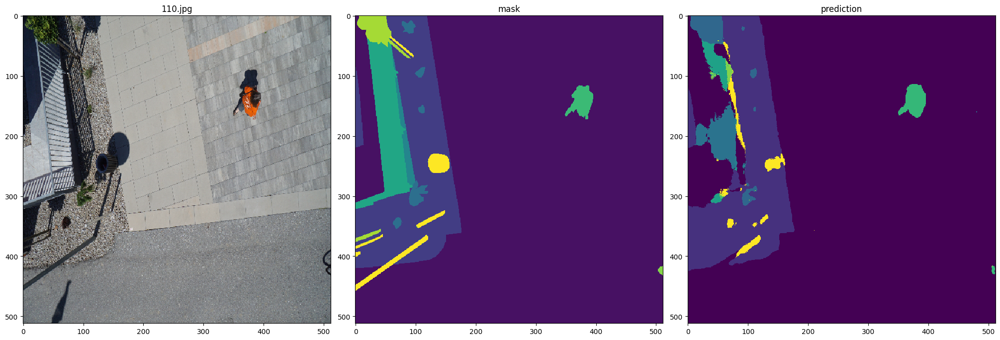

109.png - IoU results
     Class      IoU
paved-area 0.977835
      dirt 0.354582
     grass 0.976881
    gravel 0.913034
vegetation 0.793067
     fence 0.000000
    person 0.484634
   bicycle 0.000000
  obstacle 0.404364


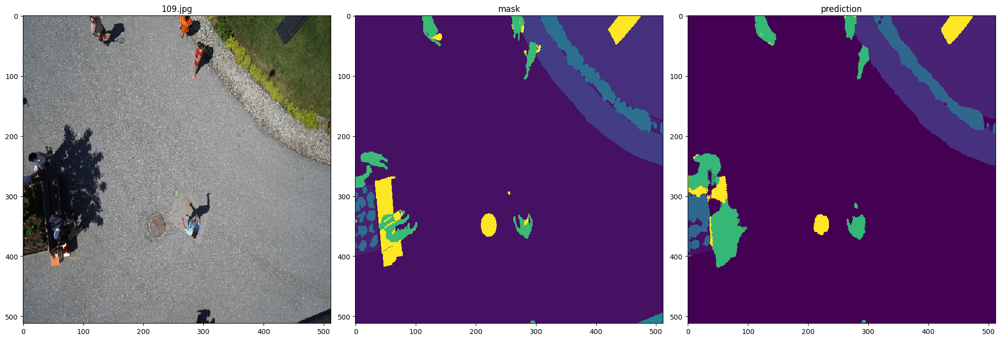

261.png - IoU results
     Class      IoU
paved-area 0.910541
      dirt 0.494326
     grass 0.941319
    gravel 0.732630
     rocks 0.000000
vegetation 0.794133
      roof 0.283847
      wall 0.727187
    window 0.700146
     fence 0.677491
    person 0.436686
       car 0.000000
 ar-marker 0.000000
  obstacle 0.082222


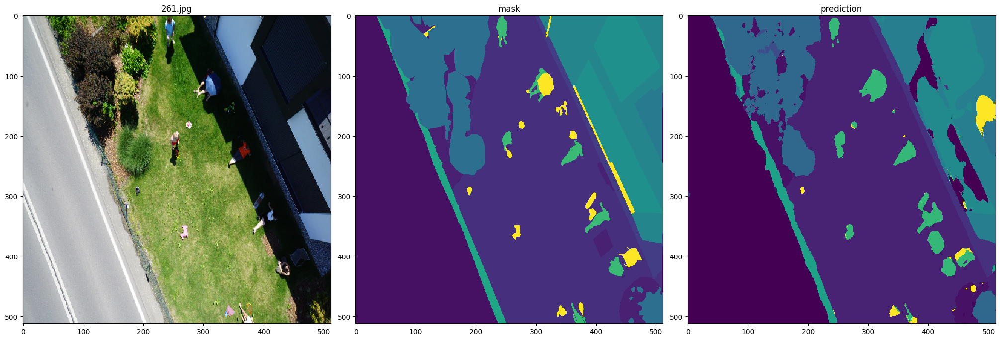

329.png - IoU results
     Class      IoU
paved-area 0.952013
      dirt 0.790137
     grass 0.946641
    gravel 0.000000
     rocks 0.000000
vegetation 0.000000
     fence 0.498694
    person 0.148944
   bicycle 0.000000
 bald-tree 0.001527
 ar-marker 0.832006
  obstacle 0.250315


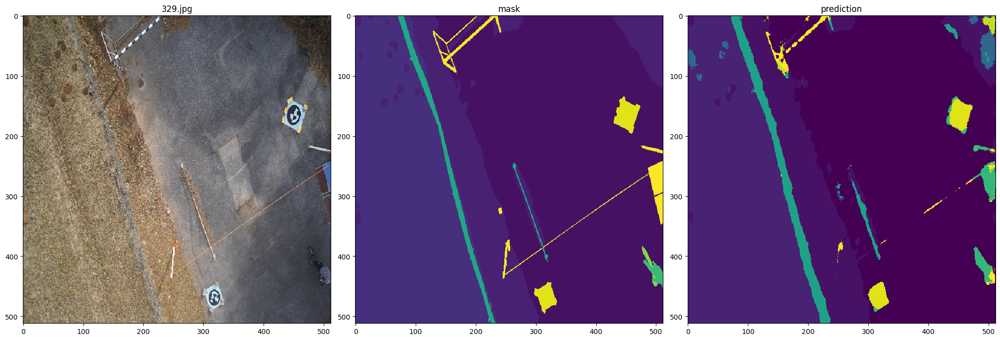

228.png - IoU results
     Class      IoU
paved-area 0.820551
      dirt 0.283465
     grass 0.850991
    gravel 0.326802
     water 0.898922
     rocks 0.118291
vegetation 0.591259
      roof 0.822899
      wall 0.221970
    window 0.000000
     fence 0.003130
    person 0.220206
       car 0.803481
   bicycle 0.007752
      tree 0.373262
 bald-tree 0.000000
 ar-marker 0.393220
  obstacle 0.439688


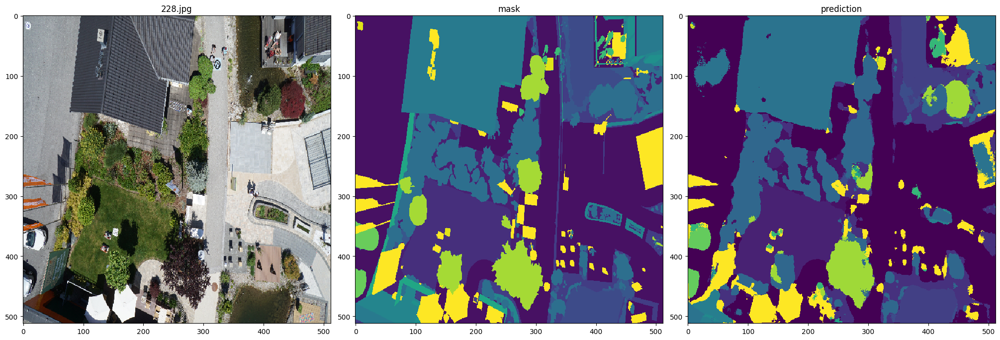

382.png - IoU results
     Class      IoU
paved-area 0.755796
      dirt 0.001416
     grass 0.007380
    gravel 0.672166
     water 0.061689
     rocks 0.021704
vegetation 0.543906
      roof 0.942023
      wall 0.531496
    window 0.000000
     fence 0.000000
    person 0.132263
       car 0.000000
   bicycle 0.000000
      tree 0.015519
  obstacle 0.457903


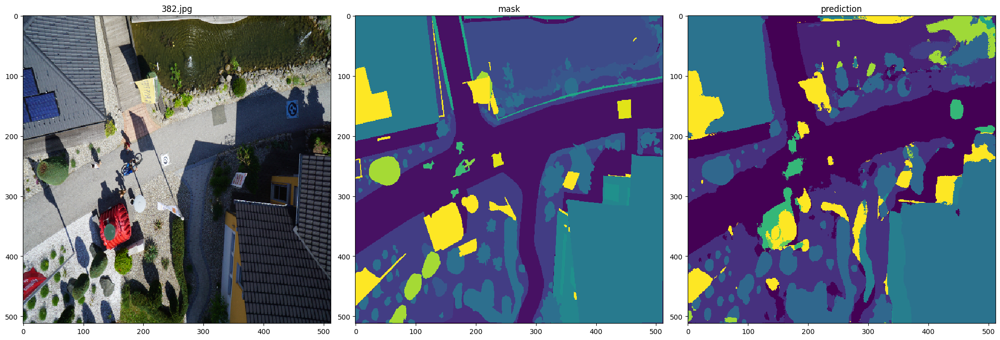

412.png - IoU results
     Class      IoU
paved-area 0.660252
      dirt 0.367674
     grass 0.905406
    gravel 0.438033
     rocks 0.344530
vegetation 0.800898
      roof 0.129506
      wall 0.486710
    window 0.052563
     fence 0.000000
    person 0.358040
       car 0.000000
   bicycle 0.000000
      tree 0.069027
 bald-tree 0.000000
 ar-marker 0.000000
  obstacle 0.183555


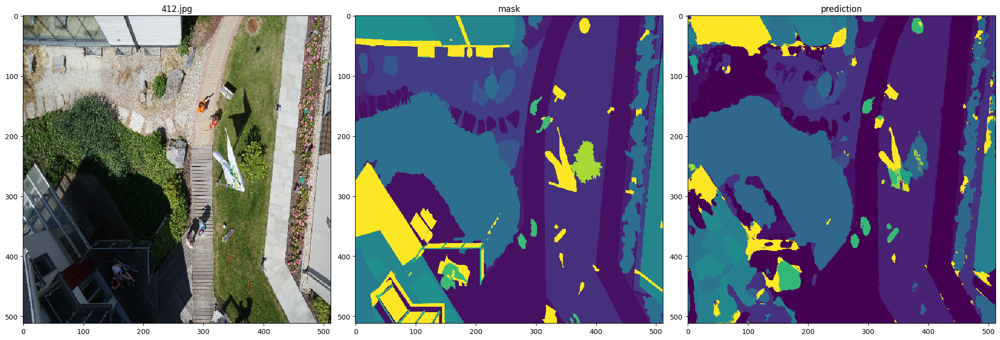

006.png - IoU results
     Class      IoU
paved-area 0.837630
      dirt 0.311824
     grass 0.000000
    gravel 0.451098
     water 0.711540
     rocks 0.320914
vegetation 0.418313
      roof 0.000000
      wall 0.000000
     fence 0.076056
    person 0.568600
   bicycle 0.000000
      tree 0.112863
 ar-marker 0.851428
  obstacle 0.067700


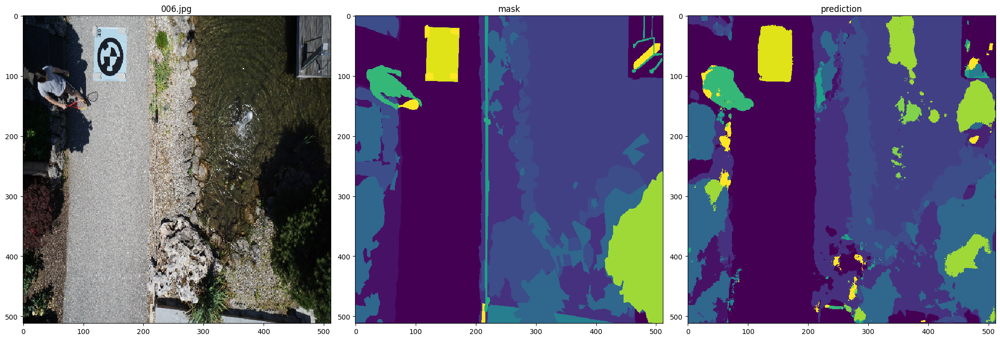

266.png - IoU results
     Class      IoU
paved-area 0.912275
      dirt 0.000000
    gravel 0.845485
     rocks 0.193821
vegetation 0.764008
      wall 0.000000
     fence 0.000000
    person 0.496610
   bicycle 0.000000
 bald-tree 0.000000
 ar-marker 0.137820
  obstacle 0.080833


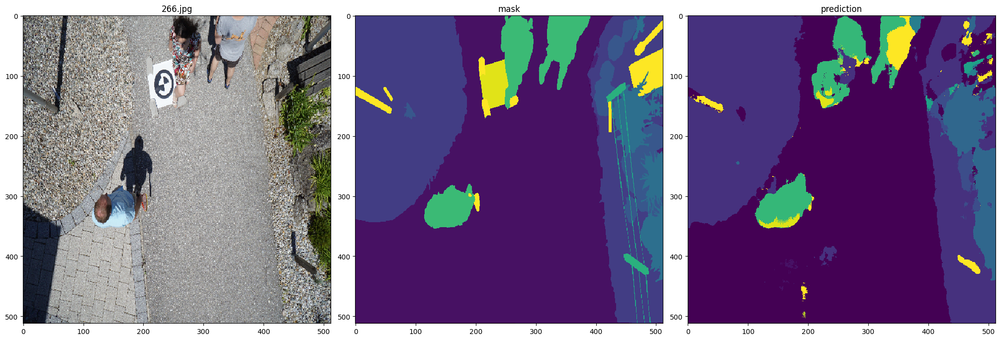

499.png - IoU results
     Class      IoU
paved-area 0.655757
      dirt 0.566342
     grass 0.000000
    gravel 0.115313
     rocks 0.001256
vegetation 0.496599
      roof 0.000000
      wall 0.000000
     fence 0.000000
    person 0.000000
   bicycle 0.000000
      tree 0.000000
 ar-marker 0.000000
  obstacle 0.274211


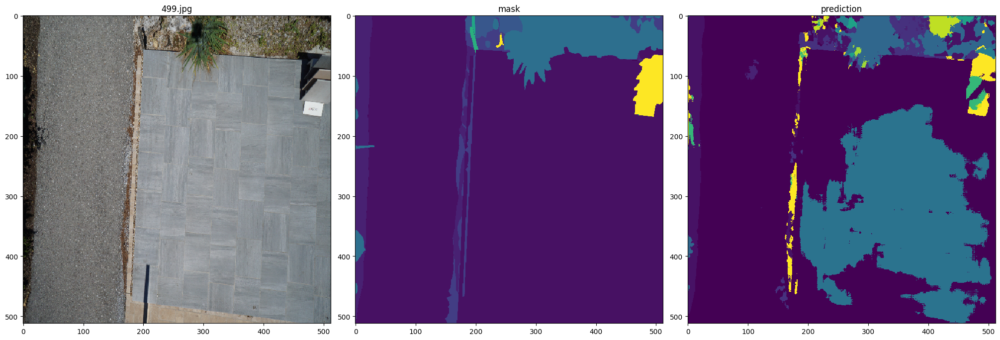

199.png - IoU results
     Class      IoU
paved-area 0.353748
      dirt 0.502982
     grass 0.803237
    gravel 0.798916
     rocks 0.000000
vegetation 0.087216
      roof 0.000000
      wall 0.000830
    window 0.918025
     fence 0.000000
    person 0.670325
   bicycle 0.000000
      tree 0.000000
  obstacle 0.361262


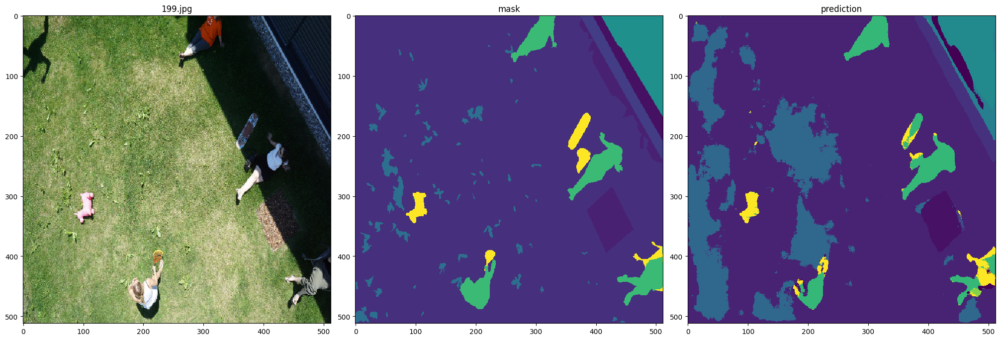

028.png - IoU results
     Class      IoU
paved-area 0.910424
      dirt 0.001319
    gravel 0.872840
     water 0.000000
      pool 0.000000
vegetation 0.460223
      roof 0.000000
      wall 0.000000
     fence 0.000000
    person 0.492499
   bicycle 0.000000
      tree 0.000000
 ar-marker 0.675579
  obstacle 0.000749


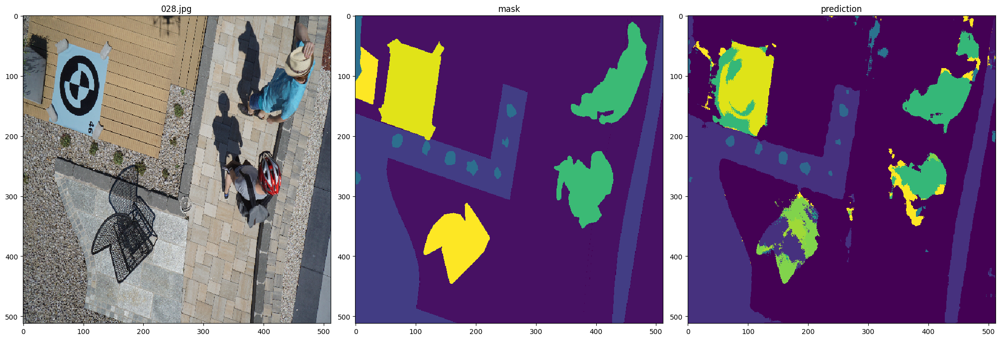

013.png - IoU results
     Class      IoU
 unlabeled 0.000000
paved-area 0.938257
      dirt 0.695301
     grass 0.000000
    gravel 0.697129
     rocks 0.449383
vegetation 0.571594
      roof 0.924493
      wall 0.031585
     fence 0.000000
    person 0.000000
  obstacle 0.265562


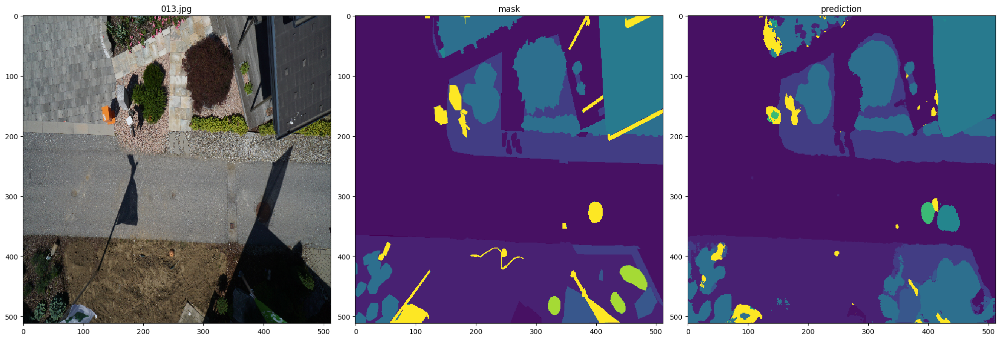

514.png - IoU results
     Class      IoU
 unlabeled 0.000000
paved-area 0.762442
      dirt 0.235361
     grass 0.872011
    gravel 0.792697
     water 0.953982
      pool 0.929665
vegetation 0.360333
      roof 0.927815
      wall 0.397054
    window 0.428024
     fence 0.000000
    person 0.114181
       car 0.164610
   bicycle 0.291448
 bald-tree 0.500134
 ar-marker 0.038446
  obstacle 0.528024


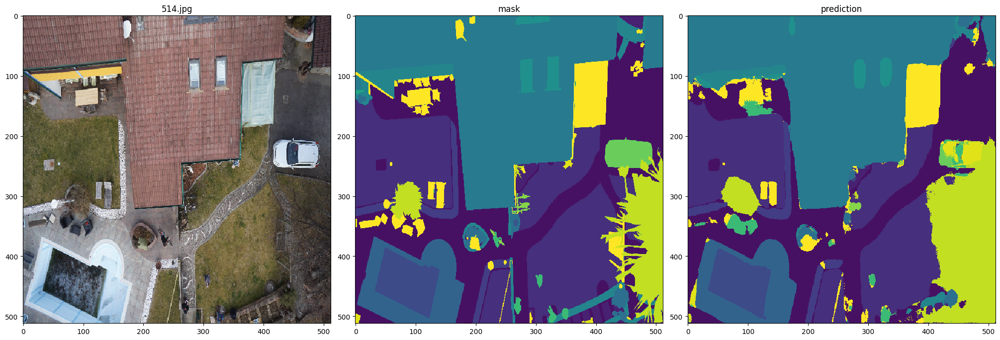

451.png - IoU results
     Class      IoU
paved-area 0.901039
      dirt 0.623532
     grass 0.972090
    gravel 0.000000
     water 0.000000
     rocks 0.023055
vegetation 0.956858
      roof 0.000000
      wall 0.137248
    window 0.275323
     fence 0.000000
    person 0.690682
   bicycle 0.000000
 ar-marker 0.000000
  obstacle 0.288879


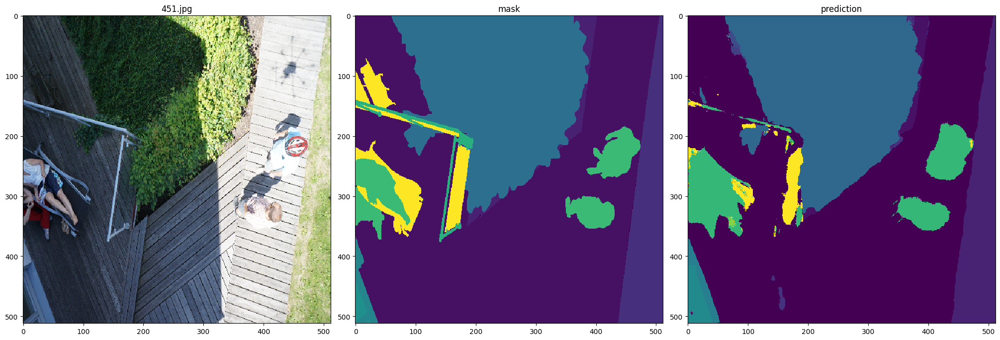

420.png - IoU results
Class      IoU
 dirt 0.000000
grass 0.981806


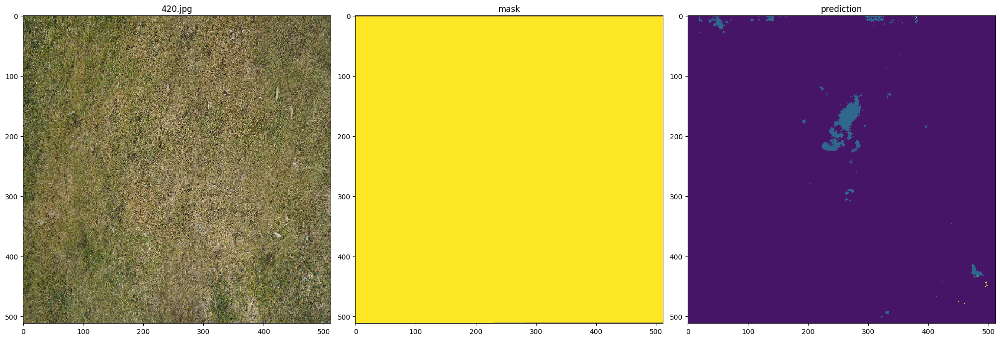

259.png - IoU results
     Class      IoU
paved-area 0.753741
      dirt 0.003750
     grass 0.863660
    gravel 0.487573
     water 0.000000
     rocks 0.091423
vegetation 0.443646
      roof 0.413966
      wall 0.384477
    window 0.017138
     fence 0.000000
    person 0.161233
       car 0.000000
   bicycle 0.000000
      tree 0.000170
 ar-marker 0.000000
  obstacle 0.140612


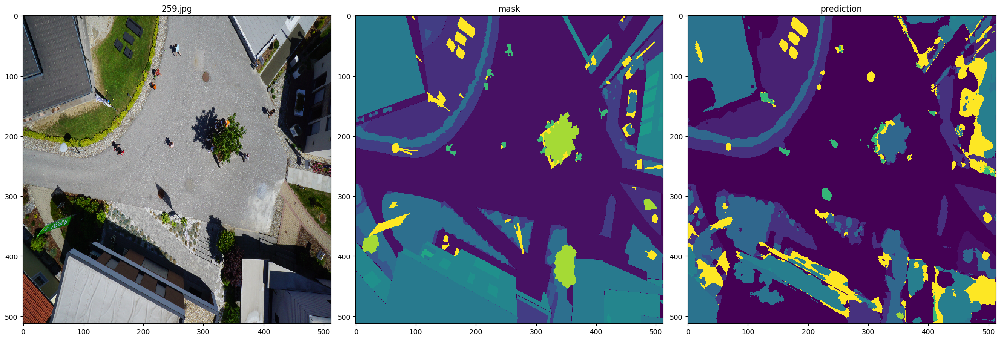

175.png - IoU results
     Class      IoU
paved-area 0.779438
     grass 0.000947
    gravel 0.171480
     water 0.000000
vegetation 0.076717
      roof 0.000000
      wall 0.000000
    window 0.000000
     fence 0.028983
    person 0.343383
       car 0.704973
   bicycle 0.000000
      tree 0.000000
 ar-marker 0.000000
  obstacle 0.008885


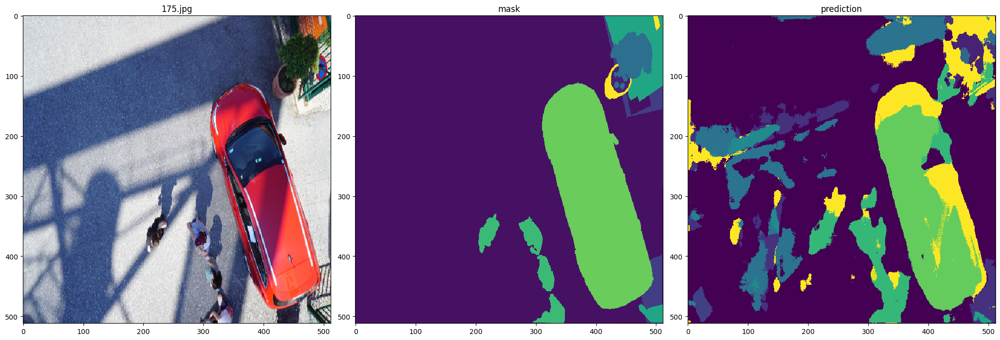

355.png - IoU results
     Class      IoU
paved-area 0.940045
      dirt 0.018692
    gravel 0.716744
     rocks 0.000000
vegetation 0.787485
      roof 0.000000
      wall 0.351268
    window 0.000000
     fence 0.536165
    person 0.275801
       car 0.809770
   bicycle 0.070968
 ar-marker 0.000000
  obstacle 0.122281


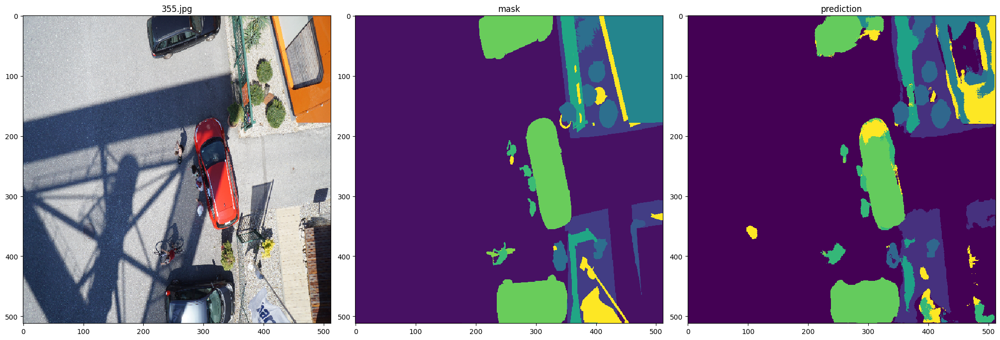

508.png - IoU results
     Class      IoU
paved-area 0.000000
      dirt 0.318101
     grass 0.991714
     fence 0.000000
   bicycle 0.205882


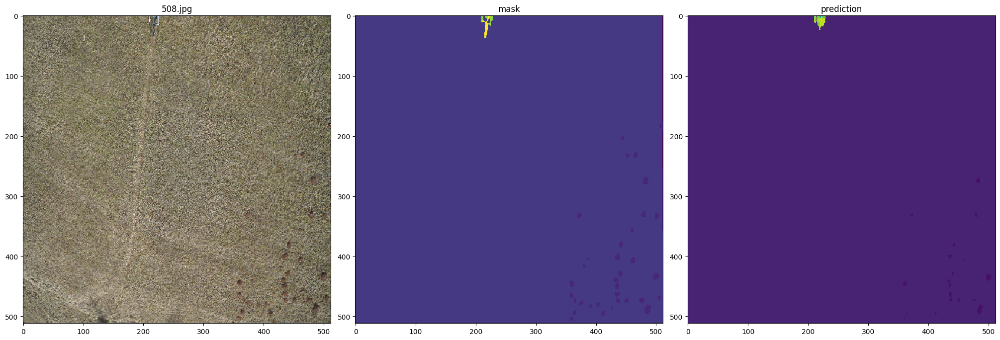

567.png - IoU results
     Class      IoU
paved-area 0.920813
      dirt 0.589938
     grass 0.002985
    gravel 0.298013
     rocks 0.000000
vegetation 0.832308
      roof 0.952444
      wall 0.004773
    window 0.836741
    person 0.443258
       car 0.000000
   bicycle 0.275261
      tree 0.050398
 bald-tree 0.000000
  obstacle 0.350546


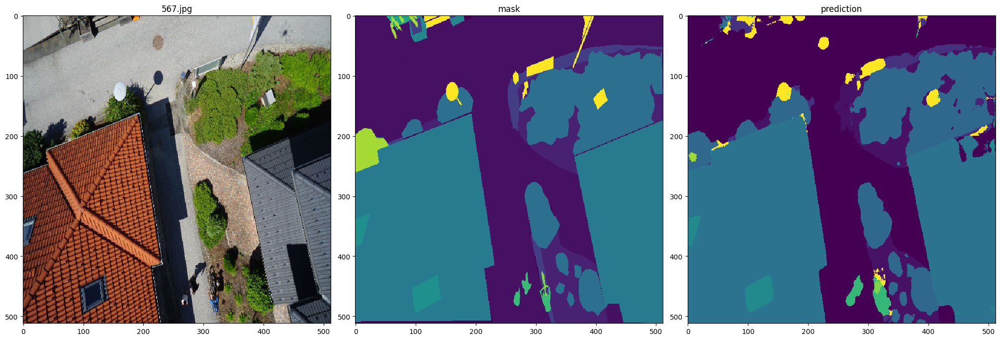

298.png - IoU results
     Class      IoU
paved-area 0.864716
      dirt 0.427910
     grass 0.958141
vegetation 0.000000
      wall 0.002384
     fence 0.520240
    person 0.547826
       car 0.000000
   bicycle 0.000000
 bald-tree 0.007005
 ar-marker 0.708333
  obstacle 0.274968


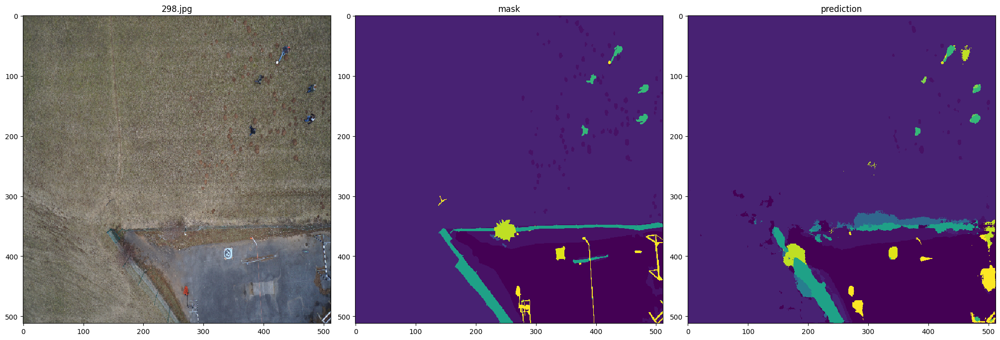

182.png - IoU results
     Class      IoU
paved-area 0.893780
      dirt 0.537731
     grass 0.000000
    gravel 0.712198
     rocks 0.000000
vegetation 0.685315
      roof 0.000000
      wall 0.033362
    window 0.000000
     fence 0.000000
    person 0.013960
       car 0.059717
   bicycle 0.000000
      tree 0.000000
  obstacle 0.010538


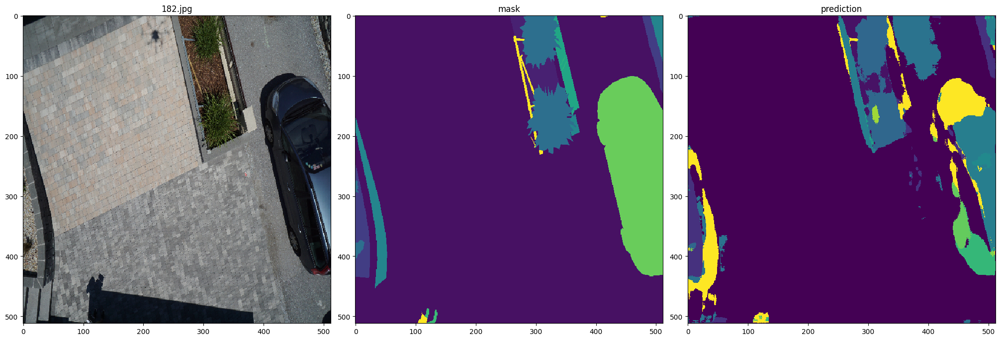

458.png - IoU results
     Class      IoU
paved-area 0.126891
      dirt 0.291132
     grass 0.880632
    gravel 0.728422
     rocks 0.001351
vegetation 0.814108
      roof 0.714699
      wall 0.185756
    window 0.000000
     fence 0.001706
    person 0.450129
      tree 0.901367
  obstacle 0.369605


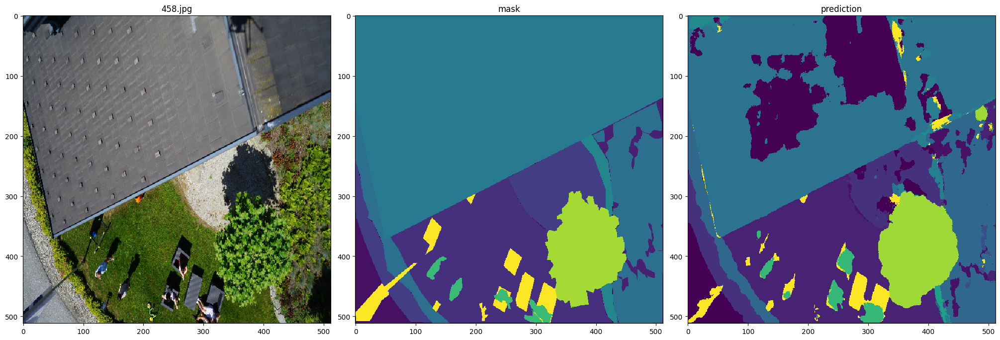

202.png - IoU results
     Class      IoU
paved-area 0.745050
      dirt 0.361682
     grass 0.904961
    gravel 0.349103
     rocks 0.000000
vegetation 0.504417
      roof 0.696143
      wall 0.274836
    window 0.107370
     fence 0.002174
    person 0.265896
       car 0.000597
   bicycle 0.000000
      tree 0.249795
  obstacle 0.189116


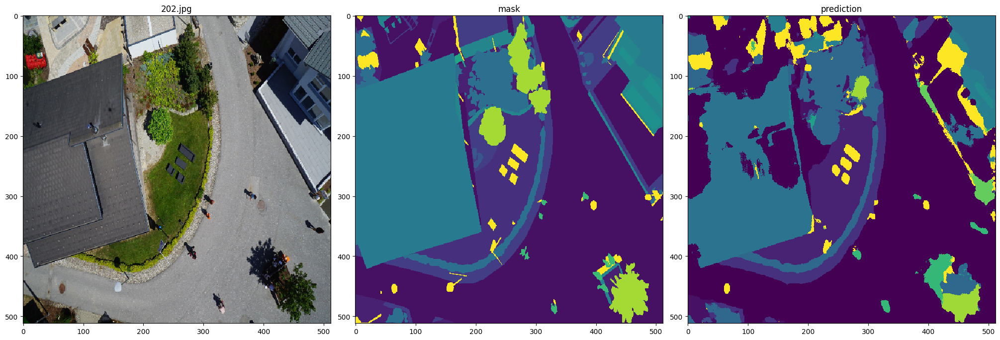

521.png - IoU results
     Class      IoU
paved-area 0.957300
      dirt 0.279360
     grass 0.000000
vegetation 0.000000
      wall 0.000000
     fence 0.006211
    person 0.429302
 bald-tree 0.000000
 ar-marker 0.000000
  obstacle 0.209926


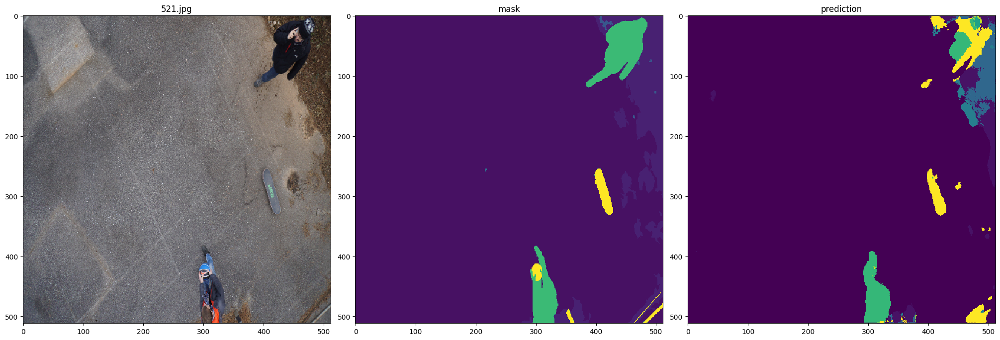

177.png - IoU results
     Class      IoU
      dirt 0.823519
     grass 0.980587
vegetation 0.000000
      wall 0.000000
     fence 0.000000
    person 0.368062
 ar-marker 0.000000
  obstacle 0.000000


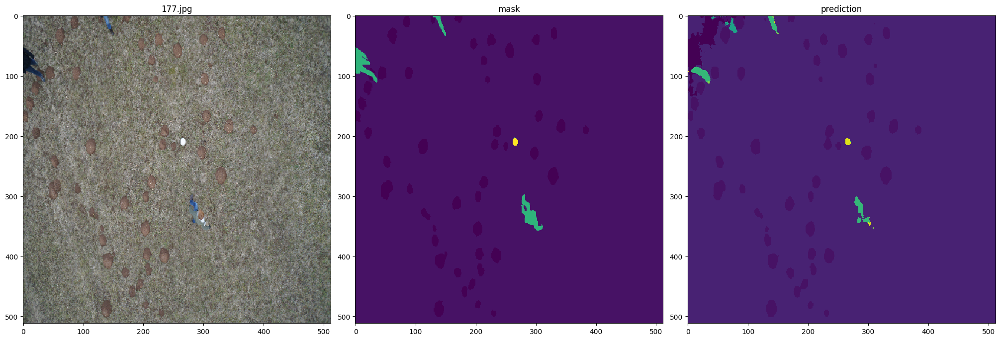

236.png - IoU results
     Class      IoU
paved-area 0.777747
      dirt 0.210226
     grass 0.533035
    gravel 0.709302
vegetation 0.379016
      roof 0.956760
      wall 0.422962
    window 0.345840
     fence 0.005036
    person 0.000000
       car 0.848434
 bald-tree 0.704182
 ar-marker 0.608025
  obstacle 0.791654


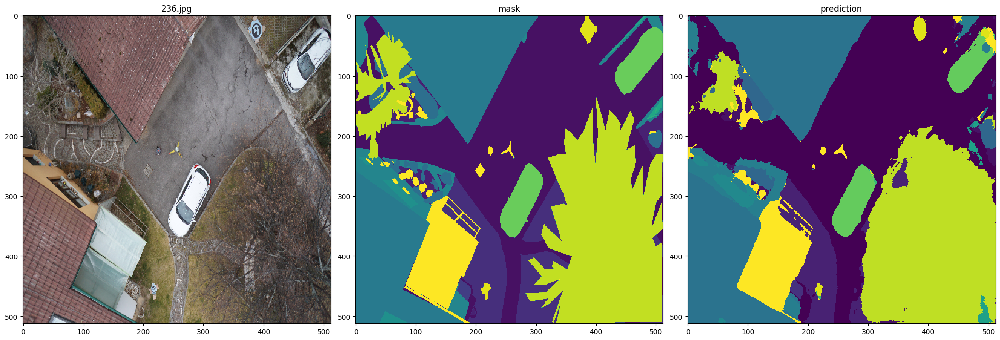

532.png - IoU results
     Class      IoU
paved-area 0.882081
      dirt 0.497845
     grass 0.939318
    gravel 0.661443
     rocks 0.000000
      pool 0.219398
vegetation 0.448890
      roof 0.640585
      wall 0.278635
    window 0.000000
     fence 0.000000
    person 0.173129
   bicycle 0.716311
      tree 0.000000
 bald-tree 0.000000
 ar-marker 0.000000
  obstacle 0.246348


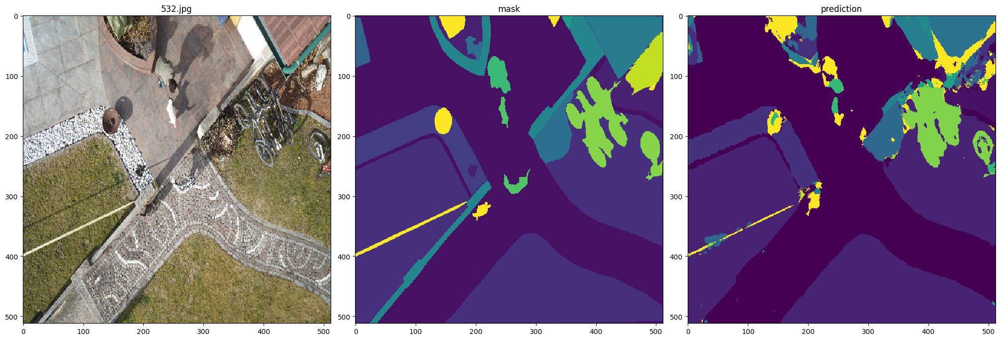

301.png - IoU results
     Class      IoU
paved-area 0.602390
      dirt 0.266506
     grass 0.635662
    gravel 0.000000
vegetation 0.336887
      roof 0.567301
      wall 0.736929
     fence 0.502679
    person 0.370268
   bicycle 0.000000
 bald-tree 0.408621
 ar-marker 0.270630
  obstacle 0.427842


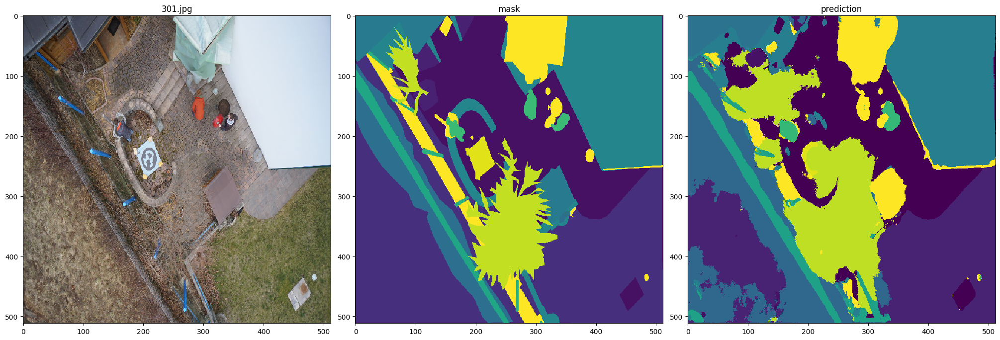

372.png - IoU results
     Class      IoU
 unlabeled 0.007380
paved-area 0.679743
      dirt 0.289495
     grass 0.829797
    gravel 0.554058
     water 0.000000
     rocks 0.390018
vegetation 0.447740
      roof 0.000000
      wall 0.522285
    window 0.094679
     fence 0.000000
    person 0.400889
       car 0.000000
   bicycle 0.000000
      tree 0.615757
 bald-tree 0.000000
 ar-marker 0.000000
  obstacle 0.338508


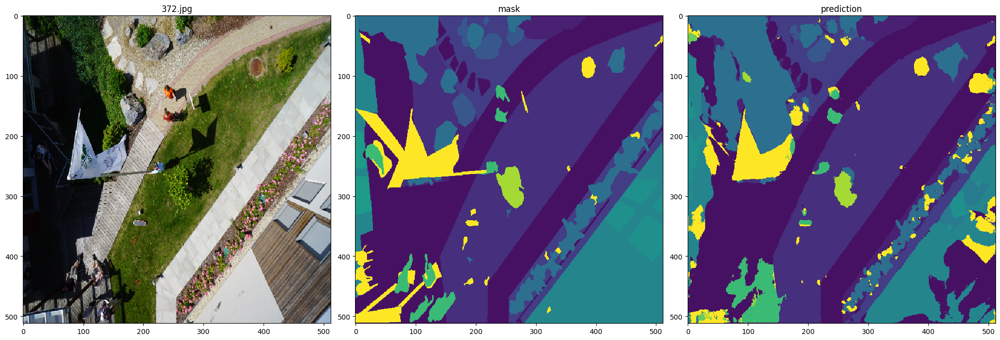

171.png - IoU results
     Class      IoU
paved-area 0.919299
      dirt 0.454113
     grass 0.270078
    gravel 0.810220
     water 0.880517
     rocks 0.435886
vegetation 0.640388
      roof 0.819096
      wall 0.590038
    window 0.250000
     fence 0.059404
    person 0.216149
       car 0.000000
   bicycle 0.121951
      tree 0.520960
  obstacle 0.426209


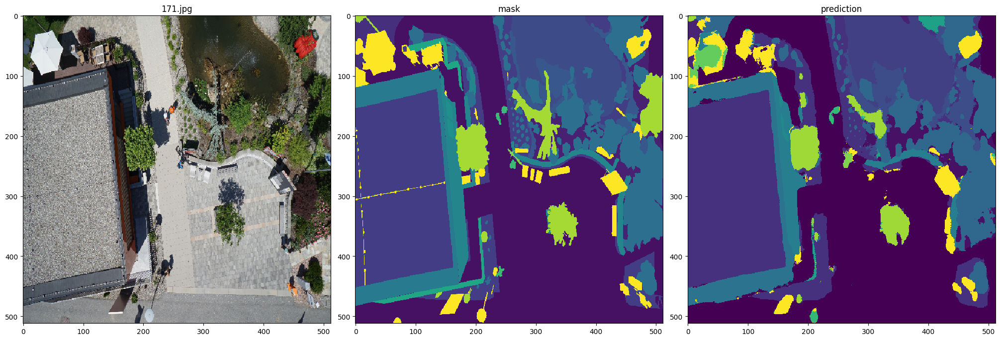

223.png - IoU results
     Class      IoU
paved-area 0.859285
      dirt 0.737455
     grass 0.820688
    gravel 0.772893
     water 0.000000
     rocks 0.324162
vegetation 0.748797
      roof 0.826393
      wall 0.539922
    window 0.251537
     fence 0.024211
    person 0.203452
       car 0.000000
   bicycle 0.000000
      tree 0.729749
  obstacle 0.298740


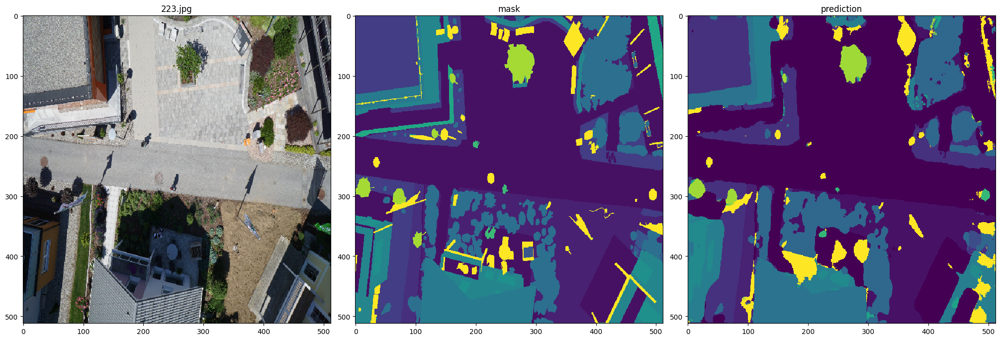

455.png - IoU results
     Class      IoU
paved-area 0.840027
      dirt 0.000000
     grass 0.000088
    gravel 0.719057
     water 0.128446
     rocks 0.091822
vegetation 0.405877
      roof 0.826736
      wall 0.250316
     fence 0.000000
    person 0.195071
       car 0.014085
   bicycle 0.000000
      tree 0.004997
 bald-tree 0.000000
 ar-marker 0.246795
  obstacle 0.522001


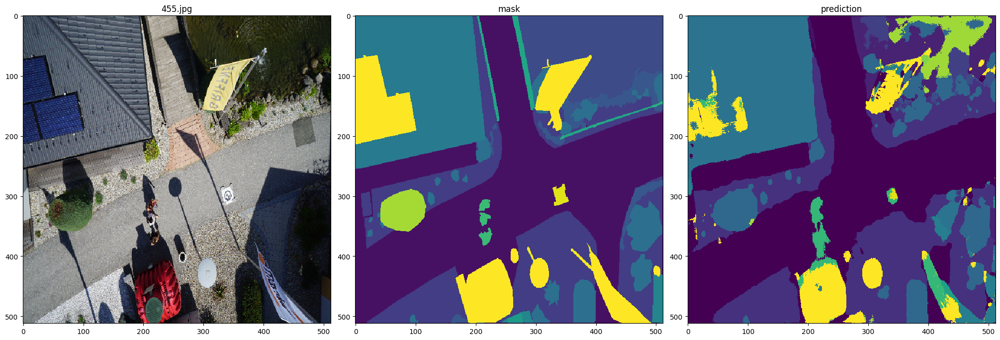

In [25]:
# This loop opens the corresponding images, masks, and predictions
for pred in os.listdir(predict_path):
    mask = label_images_path + pred
    img = original_images_path + pred.split('.')[-2] + '.jpg'
    predict = predict_path + pred

    x = cv2.imread(img, cv2.IMREAD_COLOR)
    x = cv2.cvtColor(x, cv2.COLOR_BGR2RGB)
    x = cv2.resize(x, (img_width, img_height))

    y = cv2.imread(mask, cv2.IMREAD_GRAYSCALE)
    y = cv2.resize(y, (img_width, img_height))

    p = cv2.imread(predict, cv2.IMREAD_GRAYSCALE)

    print(f'{pred} - IoU results')
    print(iou_result(mask, predict, class_dict_csv).to_string(index=False))
    
    # Plot the images
    fig, axs = plt.subplots(1, 3, figsize=(20, 20), constrained_layout=True)

    axs[0].imshow(x, interpolation='nearest')
    axs[0].set_title(pred.split('.')[-2] + '.jpg')
    axs[0].grid(False)

    axs[1].imshow(y, interpolation='nearest')
    axs[1].set_title('mask')
    axs[1].grid(False)

    axs[2].imshow(p, interpolation='nearest')
    axs[2].set_title('prediction')
    axs[2].grid(False)

    plt.show()